In [36]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from dataprep.eda import create_report

NumExpr defaulting to 4 threads.


In [5]:
sales = pd.read_csv('../data/sales_train_evaluation.csv')
sales.name = 'sales'
calendar = pd.read_csv('../data/calendar.csv')
calendar.name = 'calendar'
prices = pd.read_csv('../data/sell_prices.csv')
prices.name = 'prices'

In [8]:
#credit to @MichaelMayer on https://www.kaggle.com/mayer79/m5-forecast-keras-with-categorical-embeddings-v2
def reduce_mem_usage(df, verbose=True):
    numerics = ['int16', 'int32', 'int64', 'float16', 'float32', 'float64']
    start_mem = df.memory_usage().sum() / 1024**2    
    for col in df.columns:
        col_type = df[col].dtypes
        if col_type in numerics:
            c_min = df[col].min()
            c_max = df[col].max()
            if str(col_type)[:3] == 'int':
                if c_min > np.iinfo(np.int8).min and c_max < np.iinfo(np.int8).max:
                    df[col] = df[col].astype(np.int8)
                elif c_min > np.iinfo(np.int16).min and c_max < np.iinfo(np.int16).max:
                    df[col] = df[col].astype(np.int16)
                elif c_min > np.iinfo(np.int32).min and c_max < np.iinfo(np.int32).max:
                    df[col] = df[col].astype(np.int32)
                elif c_min > np.iinfo(np.int64).min and c_max < np.iinfo(np.int64).max:
                    df[col] = df[col].astype(np.int64)  
            elif str(col_type)[:5] == 'float':
                if c_min > np.finfo(np.float16).min and c_max < np.finfo(np.float16).max:
                    df[col] = df[col].astype(np.float16)
                elif c_min > np.finfo(np.float32).min and c_max < np.finfo(np.float32).max:
                    df[col] = df[col].astype(np.float32)
                else:
                    df[col] = df[col].astype(np.float64)
        else:
            if col == 'date':
                df[col] = pd.to_datetime(df[col], format='%Y-%m-%d')
            else:
                df[col] = df[col].astype('category')
                
    end_mem = df.memory_usage().sum() / 1024**2
    if verbose: print('Mem. usage decreased to {:5.2f} Mb ({:.1f}% reduction)'.format(end_mem, 100 * (start_mem - end_mem) / start_mem))
    return df


calendar = reduce_mem_usage(calendar)
sales = reduce_mem_usage(sales)
prices = reduce_mem_usage(prices)

Mem. usage decreased to  0.13 Mb (40.4% reduction)
Mem. usage decreased to 96.30 Mb (78.7% reduction)
Mem. usage decreased to 45.76 Mb (78.1% reduction)


In [2]:
eda_data = pd.read_pickle('data_for_eda.pkl')

In [4]:
eda_data.head()

,id,item_id,dept_id,cat_id,store_id,state_id,d,sale,date,wm_yr_wk,...,month,year,event_name_1,event_type_1,event_name_2,event_type_2,snap_CA,snap_TX,snap_WI,sell_price
0,HOBBIES_1_001_CA_1_evaluation,HOBBIES_1_001,HOBBIES_1,HOBBIES,CA_1,CA,d_1,0,2011-01-29,11101,...,1,2011,NaN,NaN,NaN,NaN,0,0,0,NaN
1,HOBBIES_1_002_CA_1_evaluation,HOBBIES_1_002,HOBBIES_1,HOBBIES,CA_1,CA,d_1,0,2011-01-29,11101,...,1,2011,NaN,NaN,NaN,NaN,0,0,0,NaN
2,HOBBIES_1_003_CA_1_evaluation,HOBBIES_1_003,HOBBIES_1,HOBBIES,CA_1,CA,d_1,0,2011-01-29,11101,...,1,2011,NaN,NaN,NaN,NaN,0,0,0,NaN
3,HOBBIES_1_004_CA_1_evaluation,HOBBIES_1_004,HOBBIES_1,HOBBIES,CA_1,CA,d_1,0,2011-01-29,11101,...,1,2011,NaN,NaN,NaN,NaN,0,0,0,NaN
4,HOBBIES_1_005_CA_1_evaluation,HOBBIES_1_005,HOBBIES_1,HOBBIES,CA_1,CA,d_1,0,2011-01-29,11101,...,1,2011,NaN,NaN,NaN,NaN,0,0,0,NaN


## EDA of Prices

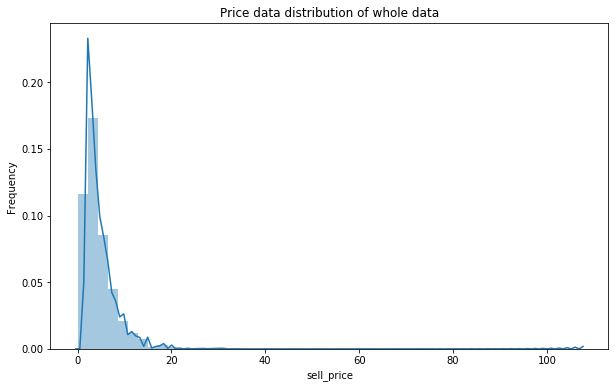

In [14]:
plt.figure(figsize=(10,6))
sns.distplot(prices["sell_price"])
plt.title("Price data distribution of whole data")
plt.ylabel("Frequency");

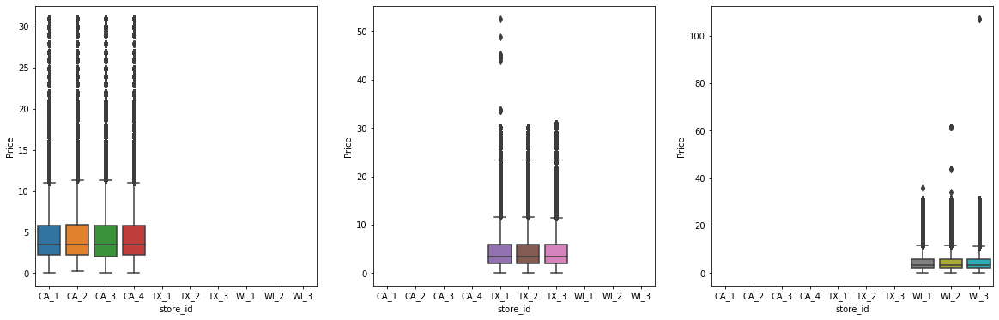

In [17]:
store_ca = prices[(prices["store_id"]=='CA_1') | (prices["store_id"]=='CA_2') | (prices["store_id"]=='CA_3') | (prices["store_id"]=='CA_4')]
store_tx = prices[(prices["store_id"]=='TX_1') | (prices["store_id"]=='TX_2') | (prices["store_id"]=='TX_3')]
store_wi = prices[(prices["store_id"]=='WI_1') | (prices["store_id"]=='WI_2') | (prices["store_id"]=='WI_3')]

fig, ax = plt.subplots(1, 3, figsize=(20, 6))
store_df = [store_ca, store_tx, store_wi]

for i in range(len(store_df)):
    sns.boxplot(x="store_id", y="sell_price", data=store_df[i], ax=ax[i])
    ax[i].set_ylabel("Price")

## EDA for Sales

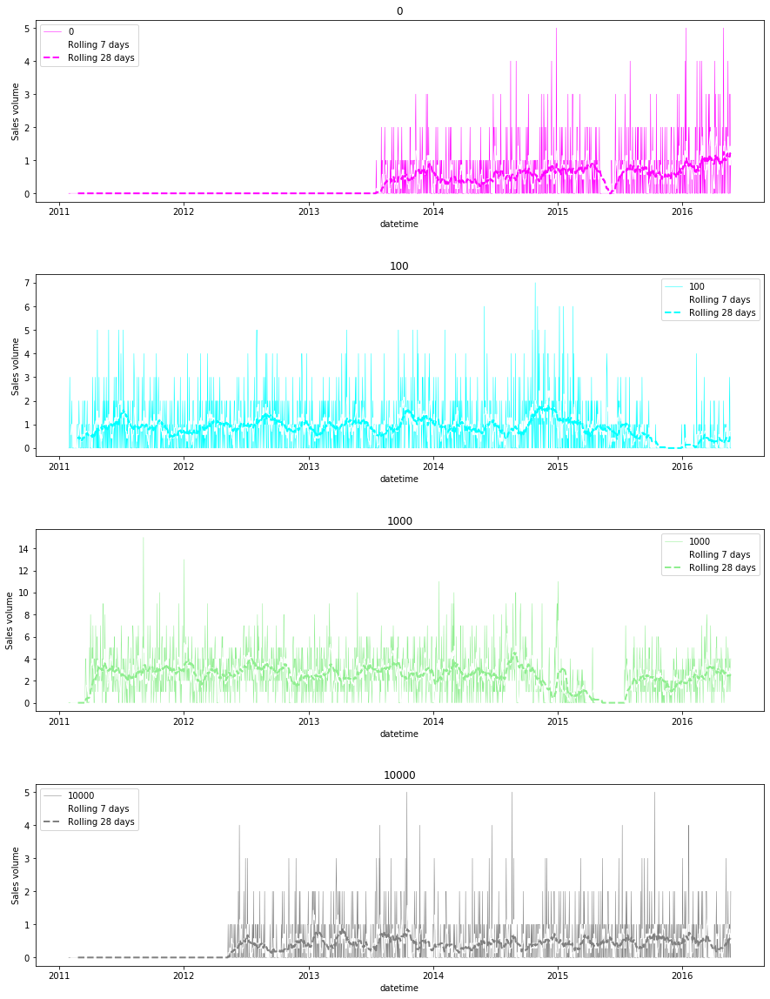

In [22]:
# sample
sample_item = sales.loc[:, "d_1":].T
sample_item = pd.merge(sample_item, calendar, left_index=True, right_on="d", how="left").set_index("date")

# Visualization
fig, ax = plt.subplots(4,1, figsize=(15,20))
plt.subplots_adjust(hspace=0.4)

color=["magenta", "cyan", "lightgreen", "gray"]
sample_col = [0, 100, 1000, 10000]


for i in range(len(sample_col)):
    ax[i].plot(sample_item.index, sample_item[sample_col[i]], color=color[i], linewidth=0.5)
    # Rolling
    ax[i].plot(sample_item.index, sample_item[sample_col[i]].rolling(7).mean(), color="white", linewidth=1)
    ax[i].plot(sample_item.index, sample_item[sample_col[i]].rolling(28).mean(), color=color[i], linewidth=2, linestyle='--')
    ax[i].set_xlabel("datetime")
    ax[i].set_ylabel("Sales volume")
    ax[i].legend(["{}".format(sample_col[i]), "Rolling 7 days", "Rolling 28 days"])
    ax[i].set_title("{}".format(sample_col[i]))

### Sales grouped by State

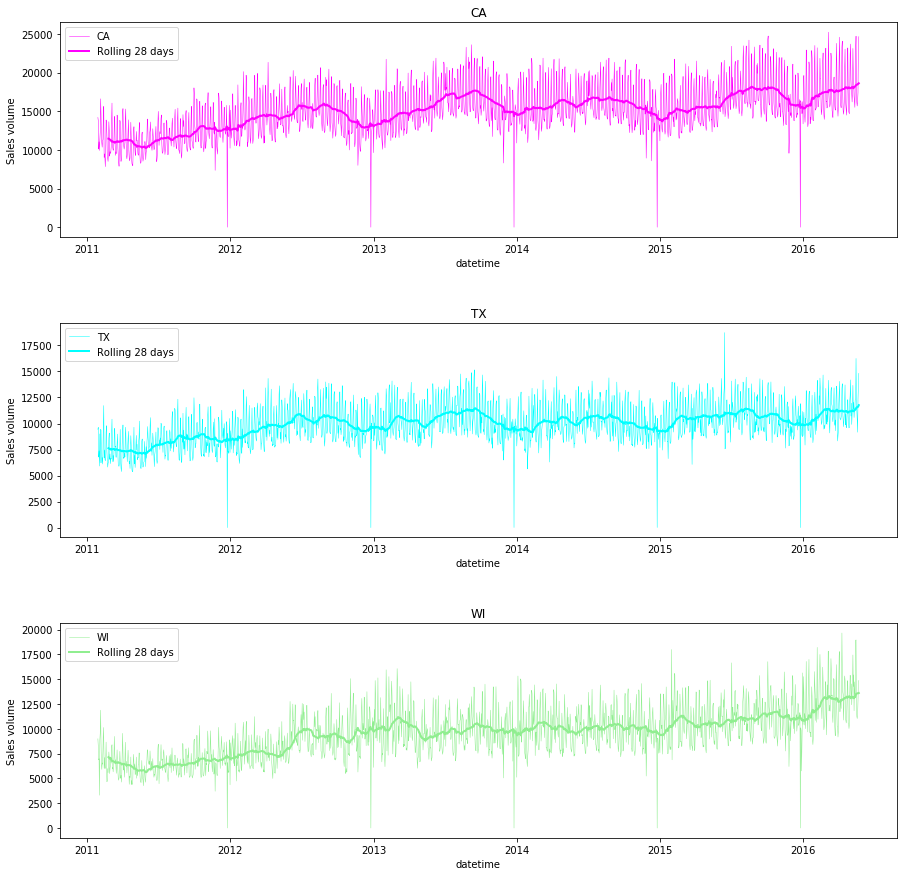

In [24]:
# Create dataframe by grouping
state_group = sales.groupby("state_id").sum().T
state_group = pd.merge(state_group, calendar, left_index=True, right_on="d", how="left").set_index("date")

# Visualization
fig, ax = plt.subplots(3,1, figsize=(15,15))
plt.subplots_adjust(hspace=0.4)

color=["magenta", "cyan", "lightgreen"]
state_col = sales["state_id"].unique()

for i in range(len(state_col)):
    ax[i].plot(state_group.index, state_group[state_col[i]], color=color[i], linewidth=0.5)
    # Rolling
    ax[i].plot(state_group.index, state_group[state_col[i]].rolling(28).mean(), color=color[i], linewidth=2)
    ax[i].set_xlabel("datetime")
    ax[i].set_ylabel("Sales volume")
    ax[i].legend(["{}".format(state_col[i]), "Rolling 28 days"])
    ax[i].set_title("{}".format(state_col[i]))

C:\Users\Yuga\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:2: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  


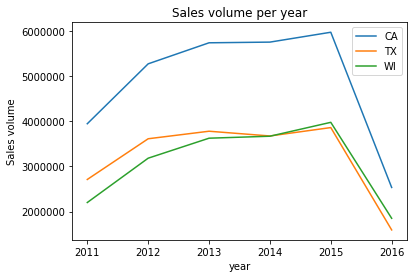

In [25]:
# Sales volume per year
state_group.groupby("year")['CA', 'TX', 'WI'].sum().plot()
plt.title("Sales volume per year")
plt.ylabel("Sales volume");

## Sales group by category

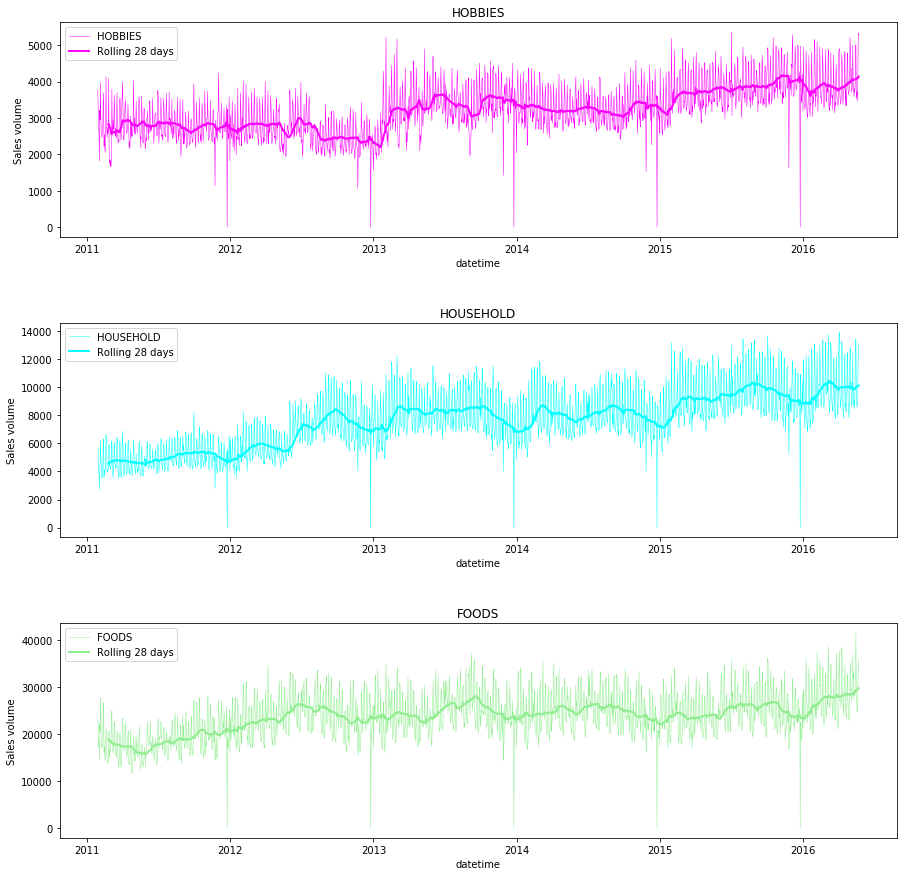

In [29]:
# Create dataframe by grouping
cate_group = sales.groupby("cat_id").sum().T
cate_group = pd.merge(cate_group, calendar, left_index=True, right_on="d", how="left").set_index("date")

# Visualization
fig, ax = plt.subplots(3,1, figsize=(15,15))
plt.subplots_adjust(hspace=0.4)

color=["magenta", "cyan", "lightgreen"]
cate_col = sales["cat_id"].unique()

for i in range(len(cate_col)):
    ax[i].plot(cate_group.index, cate_group[cate_col[i]], color=color[i], linewidth=0.5)
    # Rolling
    ax[i].plot(cate_group.index, cate_group[cate_col[i]].rolling(28).mean(), color=color[i], linewidth=2)
    ax[i].set_xlabel("datetime")
    ax[i].set_ylabel("Sales volume")
    ax[i].legend(["{}".format(cate_col[i]), "Rolling 28 days"])
    ax[i].set_title("{}".format(cate_col[i]))

C:\Users\Yuga\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:2: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  


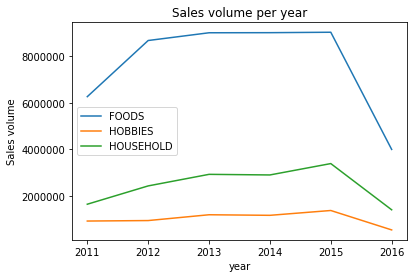

In [30]:
# Sales volume per year
cate_group.groupby("year")['FOODS', 'HOBBIES', 'HOUSEHOLD'].sum().plot()
plt.title("Sales volume per year")
plt.ylabel("Sales volume");

## Sales group by store

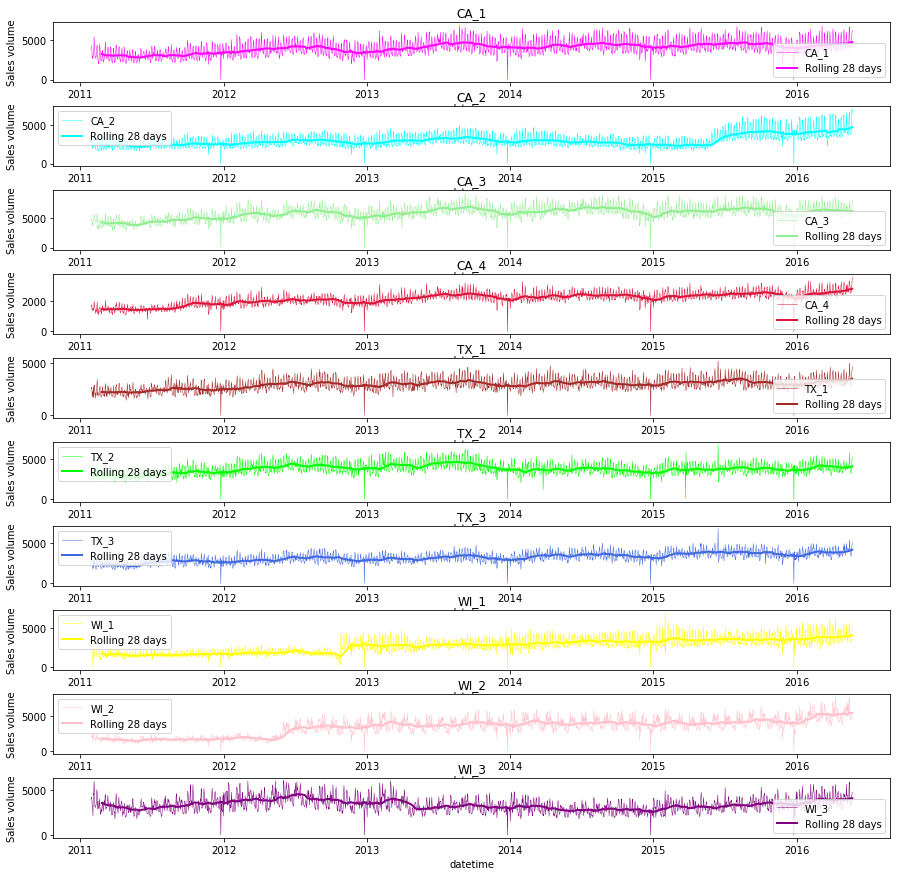

In [33]:
# Create dataframe by grouping
store_group = sales.groupby("store_id").sum().T
store_group = pd.merge(store_group, calendar, left_index=True, right_on="d", how="left").set_index("date")

# Visualization
fig, ax = plt.subplots(10,1, figsize=(15,15))
plt.subplots_adjust(hspace=0.4)

color=["magenta", "cyan", "lightgreen","crimson","brown","lime","royalblue","yellow","pink","purple"]
store_col = sales["store_id"].unique()

for i in range(len(store_col)):
    ax[i].plot(store_group.index, store_group[store_col[i]], color=color[i], linewidth=0.5)
    # Rolling
    ax[i].plot(store_group.index, store_group[store_col[i]].rolling(28).mean(), color=color[i], linewidth=2)
    ax[i].set_xlabel("datetime")
    ax[i].set_ylabel("Sales volume")
    ax[i].legend(["{}".format(store_col[i]), "Rolling 28 days"])
    ax[i].set_title("{}".format(store_col[i]))

C:\Users\Yuga\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:2: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  


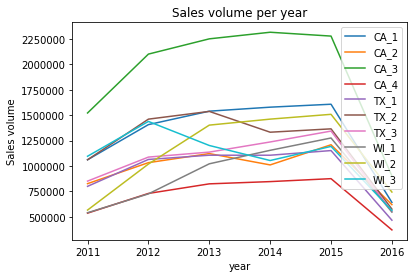

In [34]:
# Sales volume per year
store_group.groupby("year")['CA_1','CA_2','CA_3','CA_4','TX_1','TX_2','TX_3','WI_1','WI_2','WI_3'].sum().plot()
plt.title("Sales volume per year")
plt.ylabel("Sales volume");

  0%|                                                                                         | 0/1404 [00:00<…

C:\Users\Yuga\AppData\Local\Continuum\anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:871: RuntimeWarning: invalid value encountered in greater
  cond = logical_and(cond, (asarray(arg) > 0))
C:\Users\Yuga\AppData\Local\Continuum\anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:871: RuntimeWarning: invalid value encountered in greater
  cond = logical_and(cond, (asarray(arg) > 0))
C:\Users\Yuga\AppData\Local\Continuum\anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:871: RuntimeWarning: invalid value encountered in greater
  cond = logical_and(cond, (asarray(arg) > 0))
C:\Users\Yuga\AppData\Local\Continuum\anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:871: RuntimeWarning: invalid value encountered in greater
  cond = logical_and(cond, (asarray(arg) > 0))
C:\Users\Yuga\AppData\Local\Continuum\anaconda3\lib\site-packages\scipy\stats\_distn_infrastructure.py:871: RuntimeWarning: invalid value encountered in greater
  cond 

Calendar
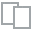
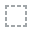
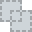
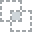
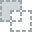
...
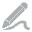
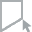
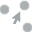
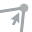
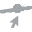

In [38]:
create_report(calendar, title='Calendar')

In [ ]:
create_report(sales, title='Sales')